# Moving Box - Encoder Decoder

In [1]:
from util import *
from util.parser import *
from util.img_kit import *
from util.notebook_display import *
from util.numeric_ops import *
from util.tf_ops import *

from IPython import display
import numpy as np
from scipy import ndimage
from scipy import misc
from os import walk
import os
import tensorflow as tf
from PIL import Image

import matplotlib.pyplot as plt
%matplotlib inline
plt.rcParams['image.interpolation'] = 'nearest'
plt.rcParams['figure.figsize'] = (5.0, 5.0) # set default size of plots
plt.rcParams['image.cmap'] = 'gray'

%load_ext autoreload
%autoreload 2

## Collect an ensemble of box data

In [25]:
def convert_to_float(collection):
    return [x/255 for x in collection]

In [4]:
train_collection = get_collection("data/tennis/train")
train_collection = convert_to_float(train_collection)
train_collection = center_collections(train_collection)
total_train = sum([x.shape[0] for x in train_collection])
print("\nAfter Augmentation: img_collections has {} collections, {} images in total".format(len(train_collection), total_train))

{'dim': (100, 160, 256, 3), 'images:': 'Tennis'}

After Augmentation: img_collections has 1 collections, 466 images in total


## Sample from Collection

In [5]:
def sample(collection, batch_size = 8, gap = 1):
    """
    Input:
        collection: [img_data] - list of ndarray
    Output:
        before_imgs, after_img, mid_imgs -  [batch size, 32, 32]
    """
    assert gap%2==1, "Gap must be odd !"      
    np.random.shuffle(collection)
    # get average number of training for each class
    n_collection = len(collection)
    num_per_collection = [x.shape[0] for x in collection]
    avg_num_per_class = int(np.ceil(batch_size/n_collection))
    # before-index for each class
    before_ind = []
    for i, imgs in enumerate(collection):
        try:
            s = np.random.choice(range(num_per_collection[i] - gap - 1), avg_num_per_class, replace=False)
            before_ind.append(s)
        except: # if not enough in this class
            before_ind.append(np.array([]))
    # after-index for each class
    after_ind = [x+gap+1 for x in before_ind]
    # mid-index for each class
    mid_ind = [x+(gap+1)//2 for x in before_ind]
    
    selected_classes = [i for i in range(n_collection) if before_ind[i].shape[0]>0]
    before_imgs = np.concatenate([collection[i][before_ind[i]] for i in selected_classes], axis = 0)
    after_imgs = np.concatenate([collection[i][after_ind[i]] for i in selected_classes], axis = 0)
    mid_imgs = np.concatenate([collection[i][mid_ind[i]] for i in selected_classes], axis = 0)
    
    before_imgs = before_imgs[:batch_size]
    mid_imgs = mid_imgs[:batch_size]
    after_imgs = after_imgs[:batch_size]
    return before_imgs, after_imgs, mid_imgs


def sample_train(batch_size = 8, gap = 1): return sample(train_collection, batch_size, gap = gap)

def sample_test(batch_size = 8, gap = 1):  return sample(test_collection, batch_size, gap)

## Take a look at Training data

Range of Image Piece Value: [-0.9450980392156862, 1.0]
Before: (4, 160, 256, 3)
After:  (4, 160, 256, 3)
Mid:    (4, 160, 256, 3)


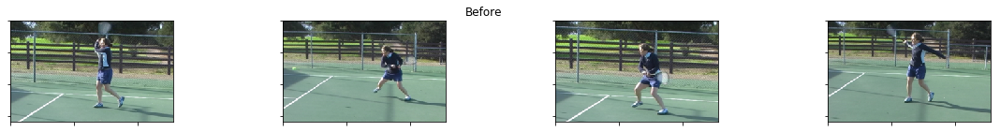

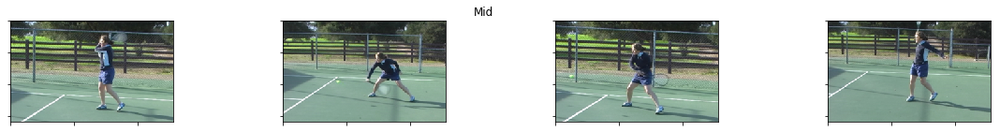

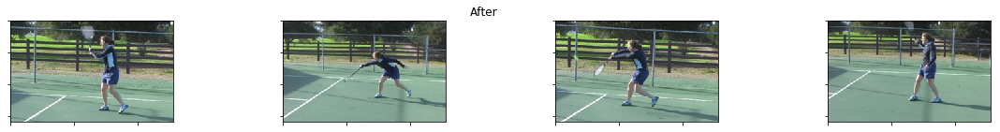

In [31]:
def show_sample_train(batch_size, gap):
    before, after, mid = sample_train(batch_size=batch_size, gap=gap)
    print("Range of Image Piece Value: [{}, {}]".format(np.min(mid), np.max(mid)))
    print("Before: {}".format(before.shape))
    print("After:  {}".format(after.shape))
    print("Mid:    {}".format(mid.shape))
    size = (20, 2)
    plot_images(convert_for_display(before), size, "Before")
    plot_images(convert_for_display(mid), size, "Mid")
    plot_images(convert_for_display(after), size, "After")
    
show_sample_train(batch_size = 4, gap = 9)

## Target

### Gap: How harsh do you want to train the model?

In [8]:
gap = 1

### Model Capacity

In [9]:
feature_channel = 64

## Param

In [10]:
batch_size = 32

learning_rate = 1e-3

beta = 0.9 # defalut 0.9 for adam
num_iteration = 1000

### Leaky Relu

In [11]:
def leaky_relu(x): return tf.maximum(x, alpha * x)

# Encoder

In [12]:
def encode(img, is_training=True):
    """
    Input:
        batch size of img
    Output:
        batch size of feature [batch_size, 20, 32, feature_channel]
    """
    x = img
    
    x = tf.layers.conv2d(x, filters = 48, kernel_size=8, strides=2, padding='same', activation=tf.nn.relu)
    
    x = tf.layers.conv2d(x, filters = 48, kernel_size=5, strides=2, padding='same', activation=tf.nn.relu)
    
    x = tf.layers.conv2d(x, filters = 48, kernel_size=4, strides=2, padding='same', activation=tf.nn.relu)

    x = tf.layers.conv2d(x, filters = 48, kernel_size=3, strides=1, padding='same', activation=tf.nn.relu)

    x = tf.layers.conv2d(x, filters = 48, kernel_size=2, padding='same', activation=tf.nn.relu)
    
    x = tf.layers.conv2d(x, filters = feature_channel, kernel_size=2, padding='same', activation=tf.nn.relu)
    return x

# Decoder

In [13]:
def decode(feature1, feature2, is_training=True):
    """
    Input:
        batch size of feature [batch_size, 20, 32, feature_channel]
    Output:
        batch size of img [batch_size, 160, 256, 3]
    """
    x = tf.concat([feature1, feature2], axis=3)

    x = tf.layers.conv2d(x, filters = 84, kernel_size=3, padding='same', activation=tf.nn.relu)
    x = tf.layers.conv2d_transpose(x, filters=48, kernel_size=5, strides=2, activation=tf.nn.relu, padding='same')
    x = tf.layers.conv2d_transpose(x, filters=48, kernel_size=4, strides=2, activation=tf.nn.relu, padding='same')
    x = tf.layers.conv2d_transpose(x, filters=48, kernel_size=3,  strides=2, activation=tf.nn.tanh, padding='same')
    x = tf.layers.conv2d_transpose(x, filters=24, kernel_size=2,  strides=1, activation=tf.nn.tanh, padding='same')
    img = tf.layers.conv2d_transpose(x, filters=3, kernel_size=2,  strides=1, activation=tf.nn.tanh, padding='same')
    return img

## Generator

In [14]:
def generate(x1, x2,  is_training=True):
    with tf.variable_scope("generator") as scope:
        feature1, feature2 = encode(x1, is_training), encode(x2, is_training)
        img = decode(feature1, feature2, is_training)
        return img

### Loss

In [15]:
def content_loss(x, gd):
    return tf.norm(x-gd)

### Get a Batch Generation

In [16]:
def get_generattion(before, after, mid):
    dic = {batch_before: before, batch_after: after, batch_mid: mid, is_training: False}
    gen_batch = sess.run(G_batch, dic)
    return gen_batch

### Solver

In [17]:
def get_solver(learning_rate=1e-3, beta1=0.5):
    return tf.train.AdamOptimizer(learning_rate=learning_rate, beta1=beta1)

### Report Loss = loss_computed * 255 / batch_size

In [18]:
def report_loss(name, num_run = 100, gap = 3, batch_size = batch_size):
    losses = []
    for _ in range(num_run):
        if name == "train": before, after, mid = sample_train(batch_size, gap)
        elif name == "val": before, after, mid = sample_dev(batch_size, gap)
        else:                before, after, mid = sample_test(batch_size, gap) 
        loss = sess.run(G_loss, \
                        feed_dict = {batch_before: before, batch_after: after, batch_mid: mid, is_training: False})
        losses.append(loss)
    return scale_loss(np.mean(losses) / batch_size, 2)

## Computational Graph

In [19]:
tf.reset_default_graph()
batch_mid        = tf.placeholder(tf.float32, [None, 160, 256, 3])
batch_before     = tf.placeholder(tf.float32, [None, 160, 256, 3])
batch_after      = tf.placeholder(tf.float32, [None, 160, 256, 3])
is_training      = tf.placeholder(tf.bool, ())

# alpha   = tf.Variable(0., "alpha") # parameter for leaky relu
G_batch = generate(batch_before, batch_after)


G_loss = content_loss(G_batch, batch_mid)
G_solver = get_solver(learning_rate, beta)

G_vars = tf.get_collection(tf.GraphKeys.TRAINABLE_VARIABLES, 'generator') 

G_train_step = G_solver.minimize(G_loss, var_list=G_vars)

In [20]:
def train(sess, G_step, G_loss, batch_size, num_iteration, plot_every = 400, show_loss_every=400, nPlot=6, num_plot = 6):
    g_losses = []
    for i in range(num_iteration):
        # get a sample
#         gap = np.random.choice([1,3,5,7,9])
        real_before, real_after, real_mid = sample_train(batch_size, gap)
        dic = {batch_mid: real_mid, batch_before: real_before, batch_after: real_after, is_training: True}
        
        _, G_loss_curr = sess.run([G_train_step, G_loss], dic)
        G_loss_curr = scale_loss(G_loss_curr/batch_size, 2)# tweek loss to match report loss
        
        g_losses.append(G_loss_curr)
    
        if i%show_loss_every ==0:
            print("Iteration {}:  G_loss = {} | Gap = {}".format(i, G_loss_curr, gap))
            
        if i%plot_every == 0:
            real_before, real_after, real_mid = sample_train(num_plot, gap)
            gen_batch_test = sess.run(G_batch, feed_dict=\
                                      {batch_before: real_before, batch_after: real_after, is_training: False})
            plot_batch_images(gen_batch_test[:nPlot], (16, 2) , "Iteration: {} | gap = {}".format(i + plot_every, gap))
            
    return g_losses

# Train !

Iteration 0:  G_loss = 3172.392497062683 | Gap = 1


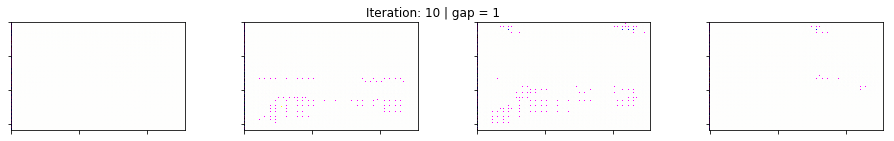

Iteration 10:  G_loss = 2705.100259780884 | Gap = 1


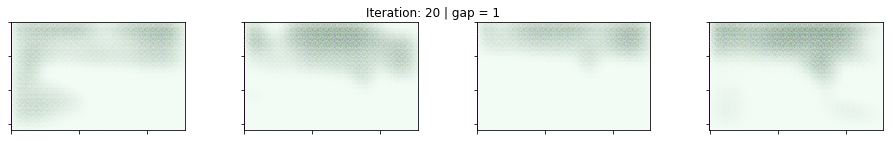

Iteration 20:  G_loss = 2203.6516857147217 | Gap = 1


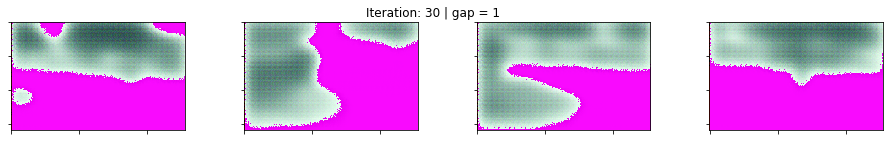

Iteration 30:  G_loss = 2081.496934890747 | Gap = 1


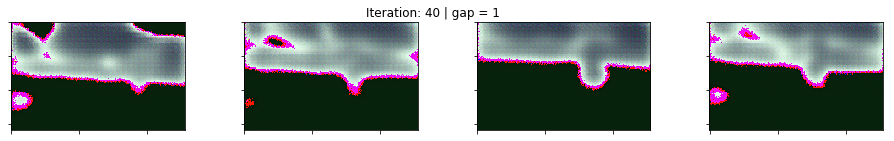

Iteration 40:  G_loss = 1822.9552817344666 | Gap = 1


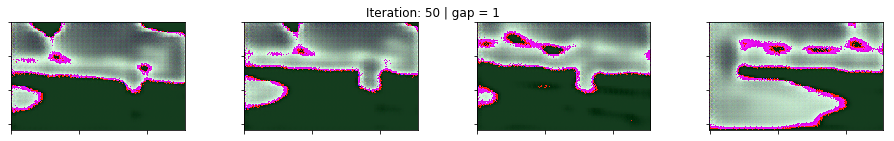

Iteration 50:  G_loss = 1742.4985814094543 | Gap = 1


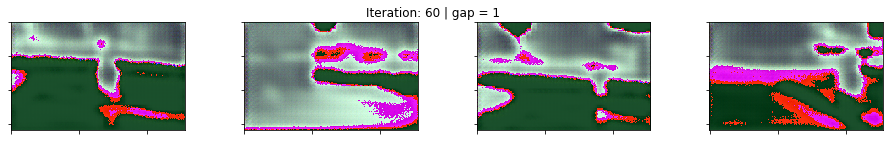

Iteration 60:  G_loss = 1594.9932932853699 | Gap = 1


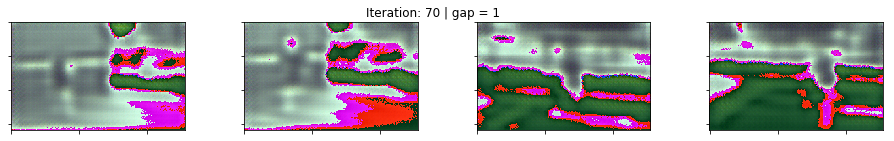

Iteration 70:  G_loss = 1573.252866268158 | Gap = 1


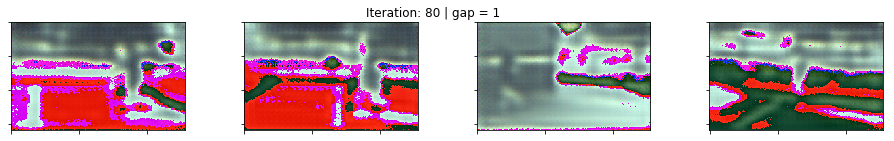

Iteration 80:  G_loss = 1529.328682422638 | Gap = 1


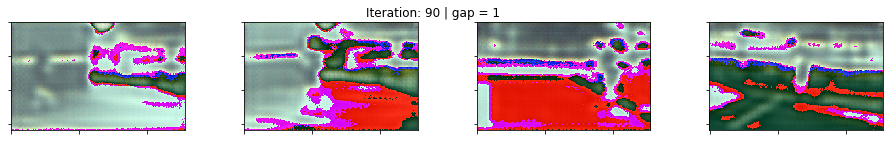

Iteration 90:  G_loss = 1471.3127875328064 | Gap = 1


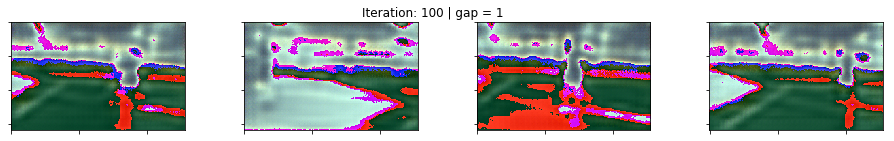

Iteration 100:  G_loss = 1420.552740097046 | Gap = 1


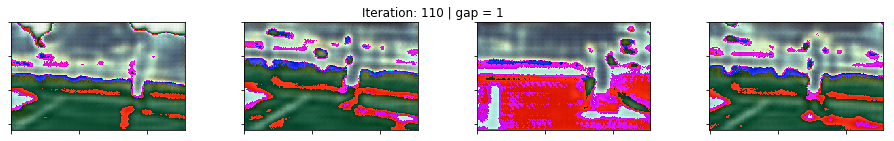

Iteration 110:  G_loss = 1370.1032423973083 | Gap = 1


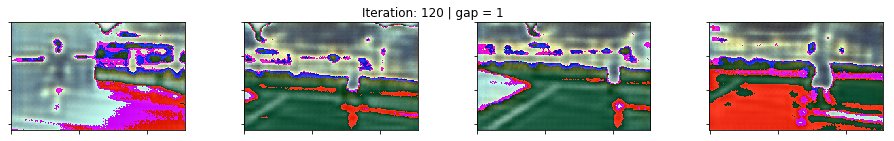

Iteration 120:  G_loss = 1390.332019329071 | Gap = 1


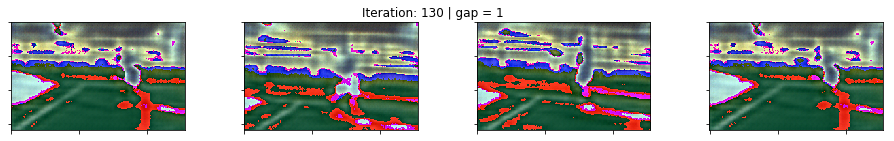

Iteration 130:  G_loss = 1287.4483752250671 | Gap = 1


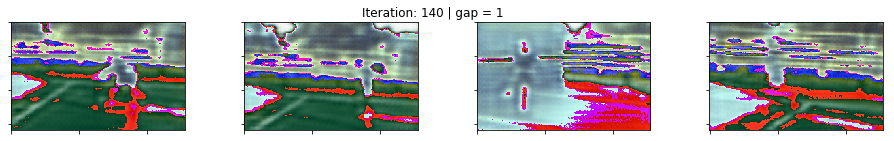

Iteration 140:  G_loss = 1255.4594421386719 | Gap = 1


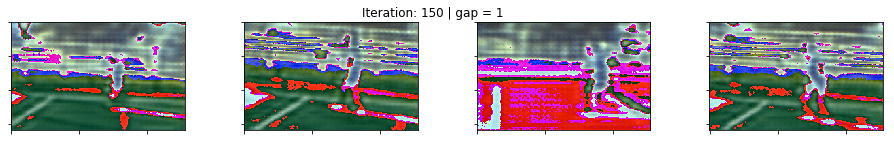

Iteration 150:  G_loss = 1208.975715637207 | Gap = 1


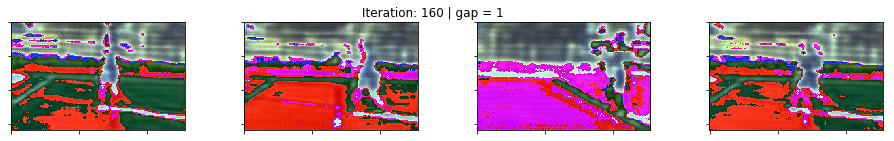

Iteration 160:  G_loss = 1304.591839313507 | Gap = 1


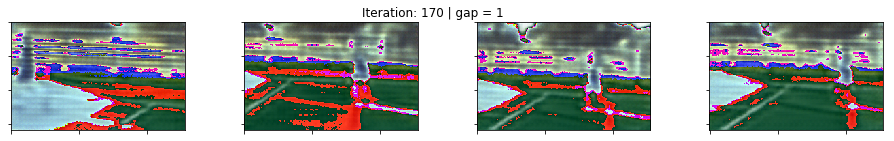

Iteration 170:  G_loss = 1185.8789134025574 | Gap = 1


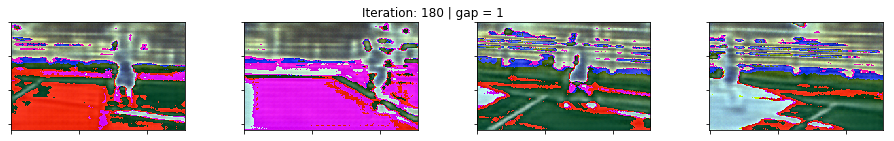

Iteration 180:  G_loss = 1135.7811856269836 | Gap = 1


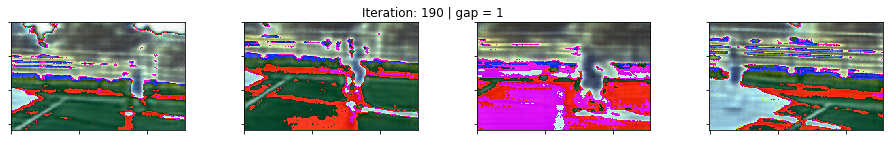

Iteration 190:  G_loss = 1131.529791355133 | Gap = 1


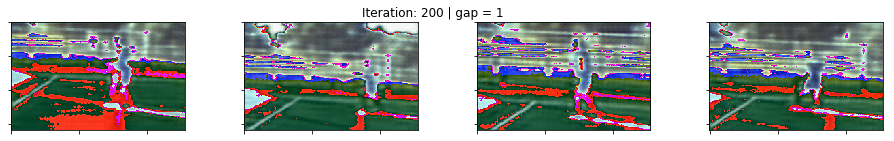

Iteration 200:  G_loss = 1142.6607012748718 | Gap = 1


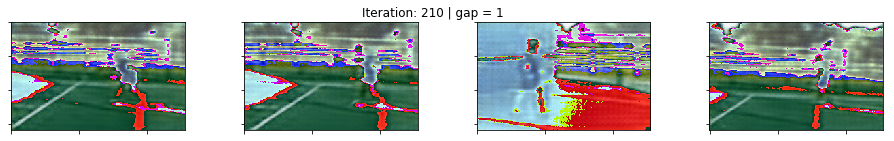

Iteration 210:  G_loss = 1088.6341667175293 | Gap = 1


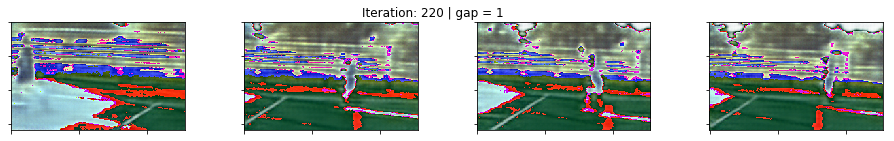

Iteration 220:  G_loss = 1080.8163142204285 | Gap = 1


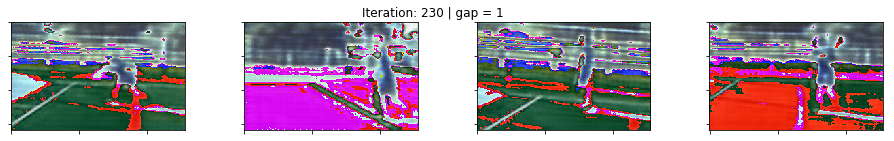

Iteration 230:  G_loss = 1071.4714908599854 | Gap = 1


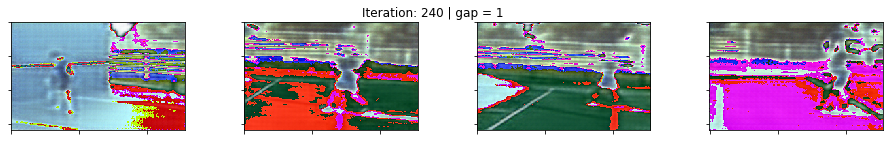

Iteration 240:  G_loss = 1028.7667679786682 | Gap = 1


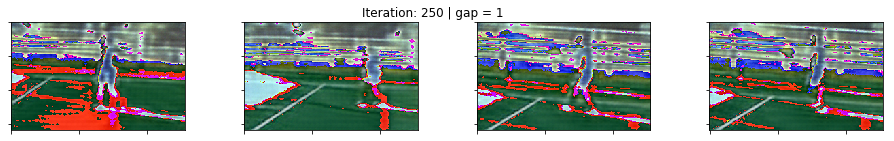

Iteration 250:  G_loss = 1028.6257195472717 | Gap = 1


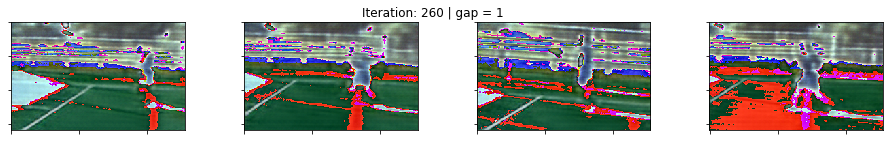

Iteration 260:  G_loss = 1036.6833543777466 | Gap = 1


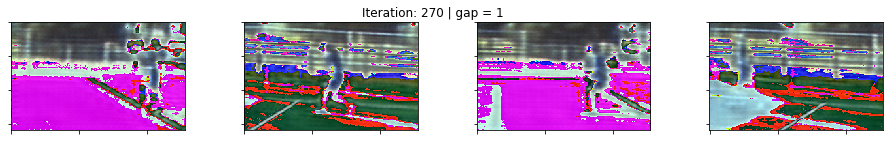

Iteration 270:  G_loss = 980.8576619625092 | Gap = 1


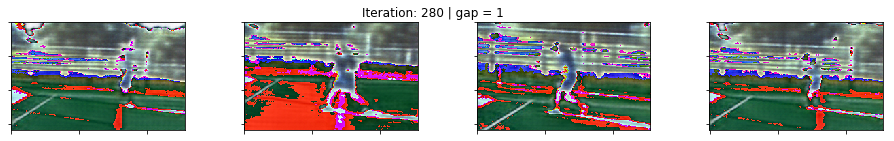

Iteration 280:  G_loss = 986.6557252407074 | Gap = 1


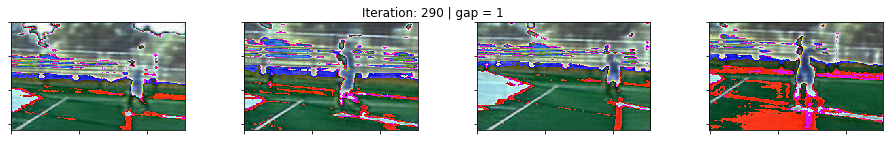

Iteration 290:  G_loss = 986.917394399643 | Gap = 1


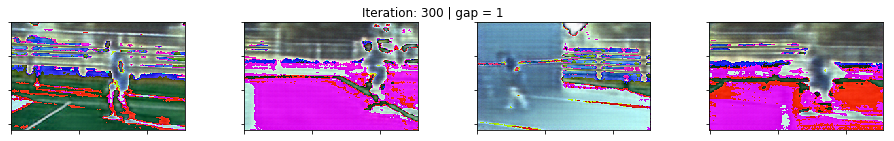

Iteration 300:  G_loss = 1041.1646819114685 | Gap = 1


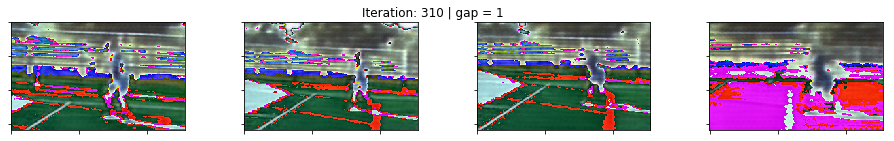

Iteration 310:  G_loss = 978.1016850471497 | Gap = 1


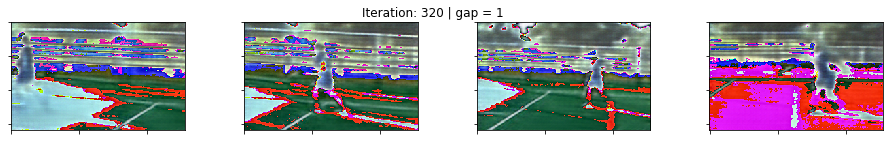

Iteration 320:  G_loss = 979.964314699173 | Gap = 1


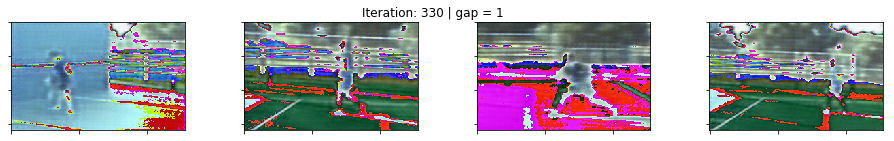

Iteration 330:  G_loss = 960.5440735816956 | Gap = 1


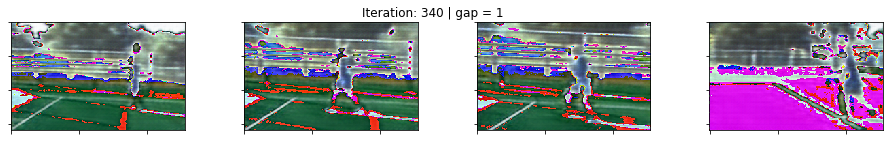

Iteration 340:  G_loss = 978.6070275306702 | Gap = 1


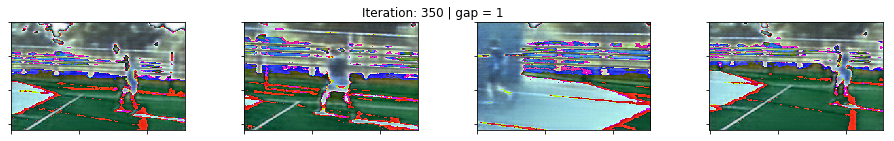

Iteration 350:  G_loss = 954.9201321601868 | Gap = 1


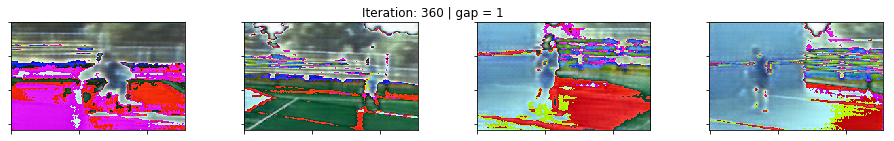

Iteration 360:  G_loss = 959.8534834384918 | Gap = 1


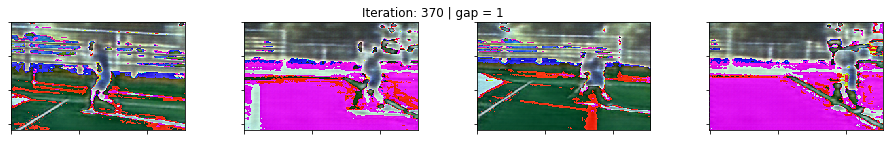

Iteration 370:  G_loss = 921.7588555812836 | Gap = 1


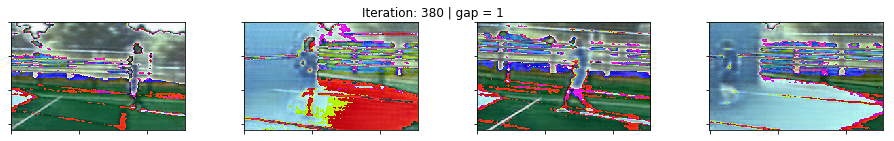

Iteration 380:  G_loss = 933.0126965045929 | Gap = 1


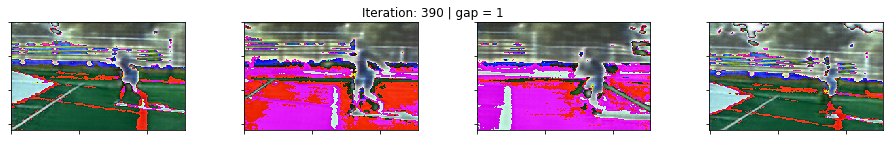

Iteration 390:  G_loss = 940.763247013092 | Gap = 1


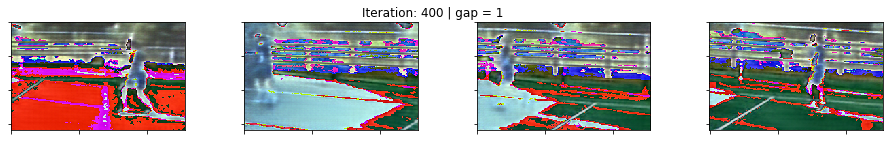

Iteration 400:  G_loss = 898.3691346645355 | Gap = 1


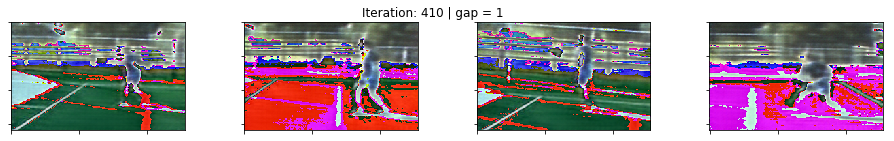

Iteration 410:  G_loss = 960.1108360290527 | Gap = 1


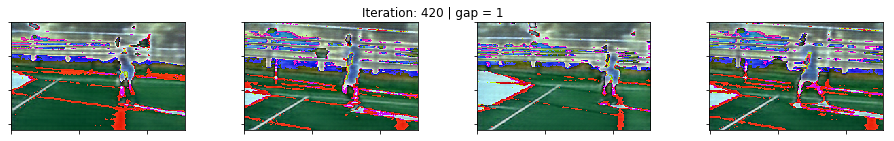

Iteration 420:  G_loss = 919.2305016517639 | Gap = 1


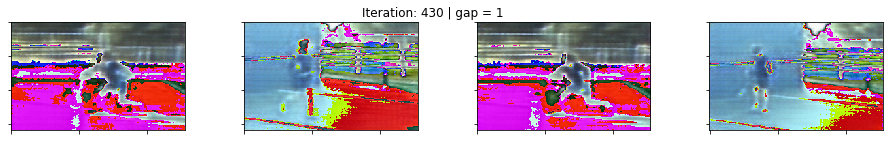

Iteration 430:  G_loss = 911.6098129749298 | Gap = 1


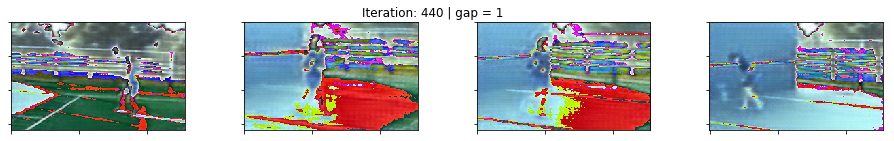

Iteration 440:  G_loss = 888.1079828739166 | Gap = 1


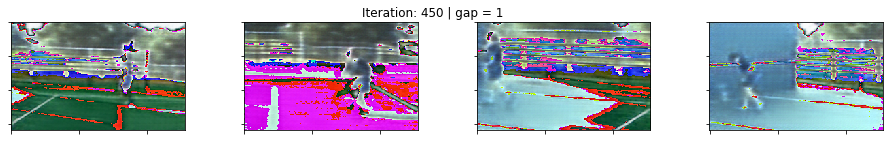

Iteration 450:  G_loss = 908.820458650589 | Gap = 1


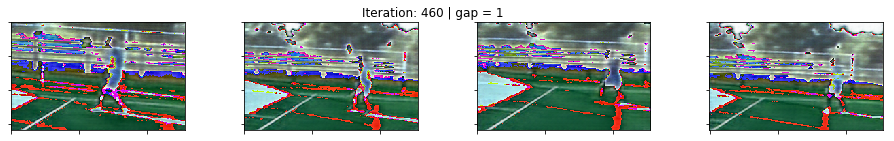

Iteration 460:  G_loss = 908.7174081802368 | Gap = 1


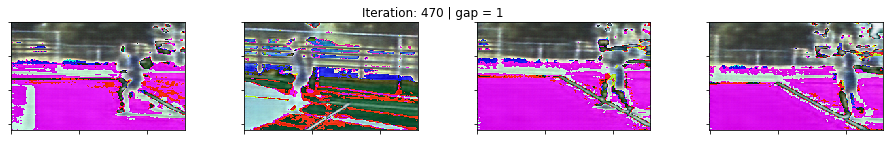

Iteration 470:  G_loss = 880.3605937957764 | Gap = 1


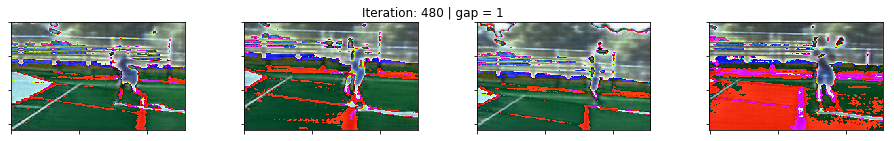

Iteration 480:  G_loss = 885.4725658893585 | Gap = 1


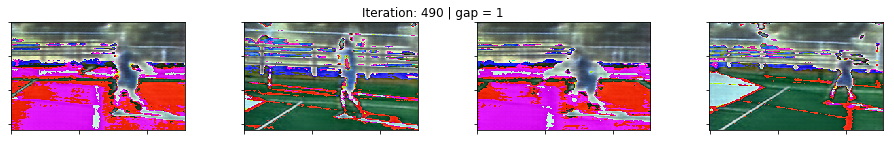

Iteration 490:  G_loss = 906.7055833339691 | Gap = 1


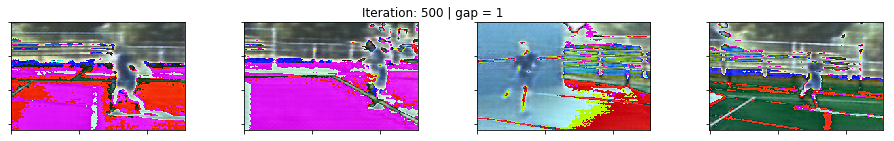

Iteration 500:  G_loss = 892.370320558548 | Gap = 1


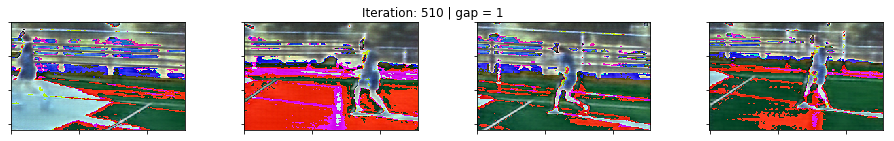

Iteration 510:  G_loss = 906.5990674495697 | Gap = 1


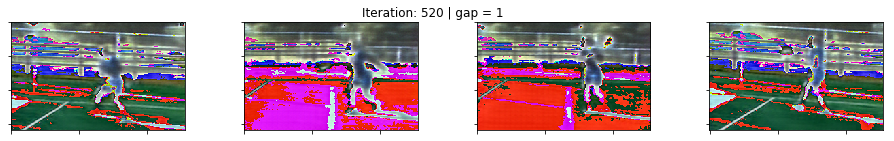

Iteration 520:  G_loss = 871.6517651081085 | Gap = 1


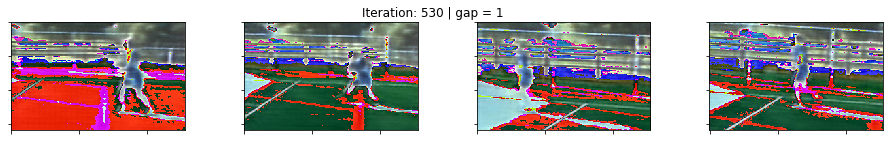

Iteration 530:  G_loss = 888.2154715061188 | Gap = 1


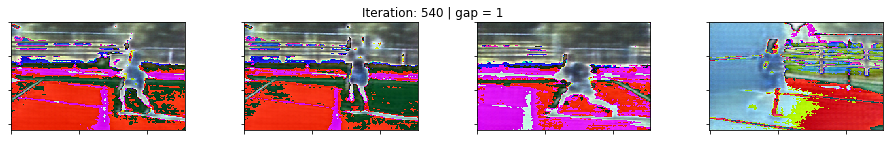

Iteration 540:  G_loss = 870.1077711582184 | Gap = 1


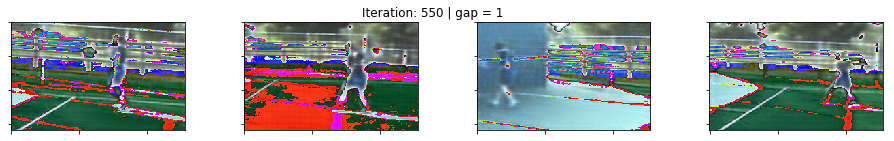

Iteration 550:  G_loss = 863.9650511741638 | Gap = 1


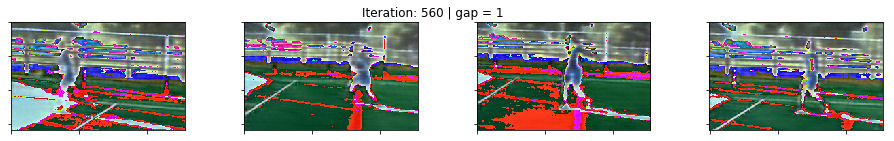

Iteration 560:  G_loss = 854.7458338737488 | Gap = 1


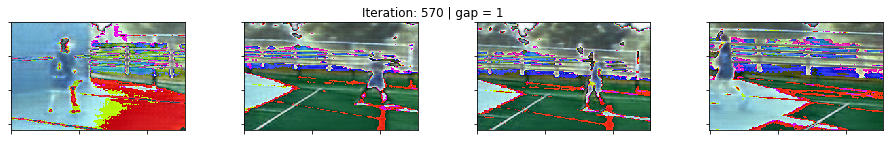

Iteration 570:  G_loss = 840.6847035884857 | Gap = 1


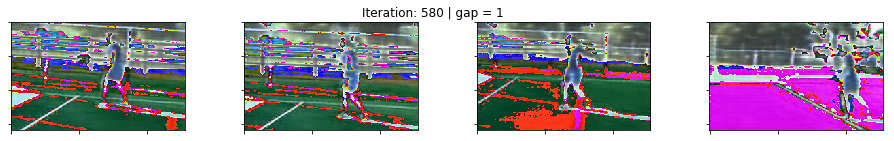

Iteration 580:  G_loss = 874.1803014278412 | Gap = 1


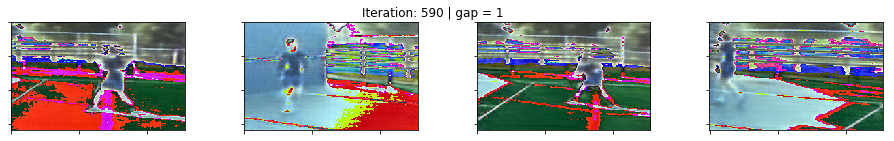

Iteration 590:  G_loss = 834.6287405490875 | Gap = 1


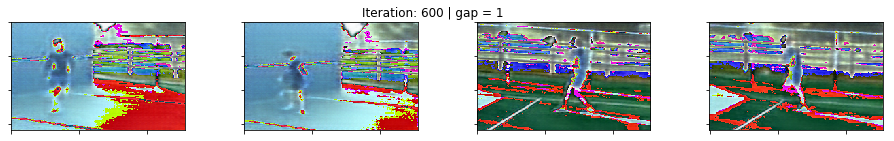

Iteration 600:  G_loss = 860.036244392395 | Gap = 1


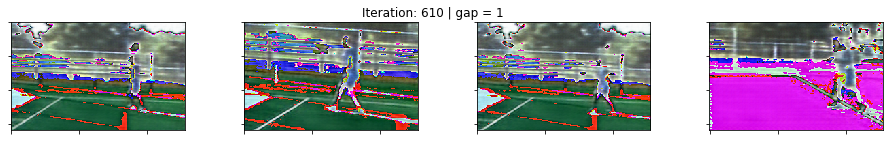

Iteration 610:  G_loss = 889.5882618427277 | Gap = 1


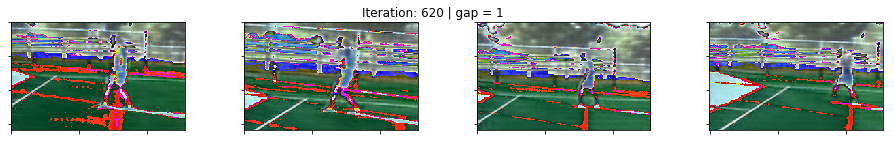

Iteration 620:  G_loss = 864.8679435253143 | Gap = 1


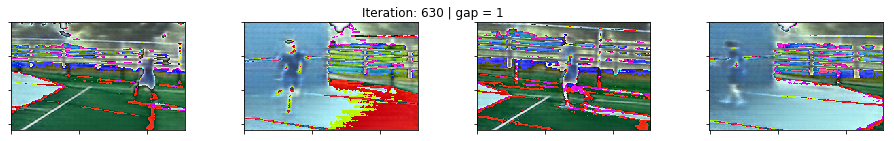

Iteration 630:  G_loss = 860.7419121265411 | Gap = 1


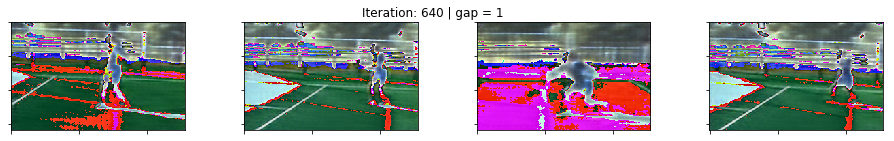

Iteration 640:  G_loss = 826.8416512012482 | Gap = 1


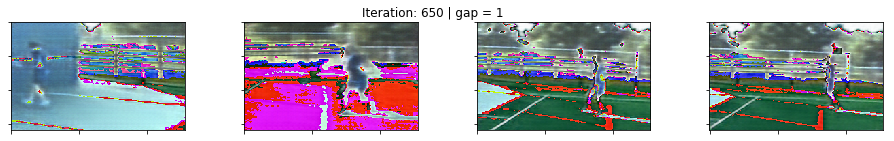

Iteration 650:  G_loss = 857.6568424701691 | Gap = 1


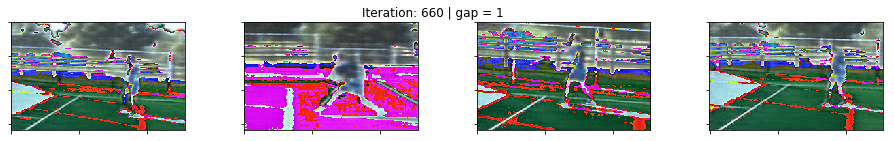

Iteration 660:  G_loss = 847.7641797065735 | Gap = 1


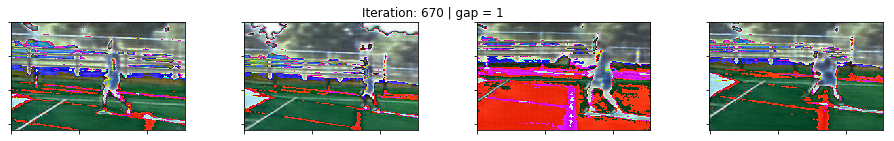

Iteration 670:  G_loss = 828.1207537651062 | Gap = 1


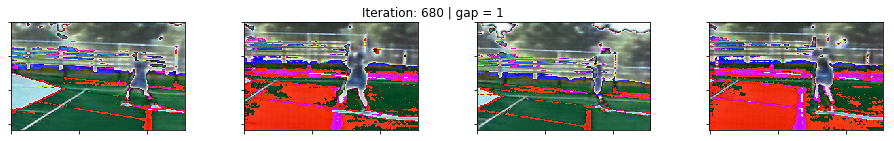

Iteration 680:  G_loss = 858.4567451477051 | Gap = 1


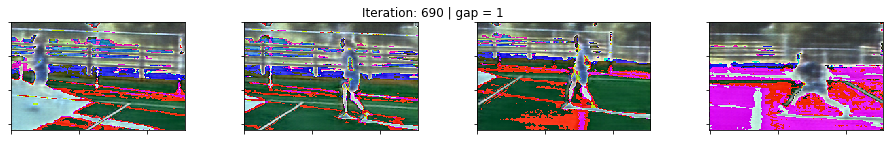

Iteration 690:  G_loss = 832.8828406333923 | Gap = 1


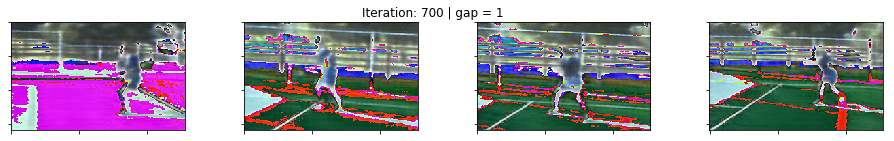

Iteration 700:  G_loss = 858.5340785980225 | Gap = 1


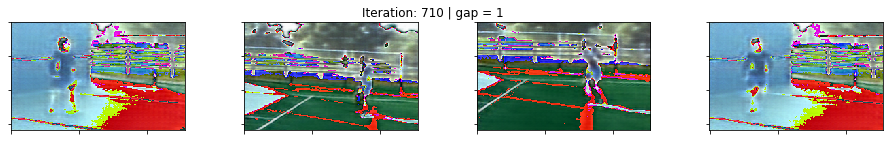

Iteration 710:  G_loss = 810.9936439990997 | Gap = 1


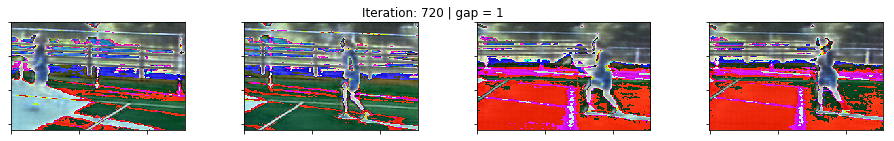

Iteration 720:  G_loss = 850.9015953540802 | Gap = 1


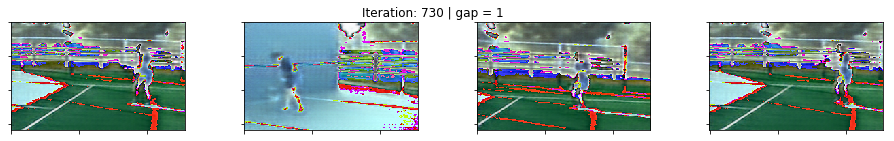

Iteration 730:  G_loss = 807.5590538978577 | Gap = 1


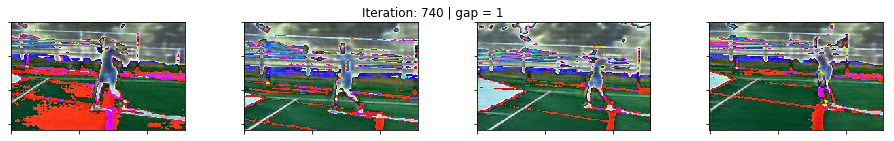

Iteration 740:  G_loss = 827.4556374549866 | Gap = 1


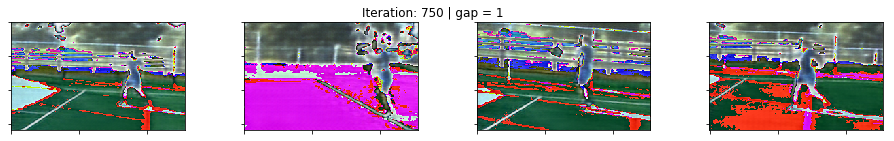

Iteration 750:  G_loss = 827.8587198257446 | Gap = 1


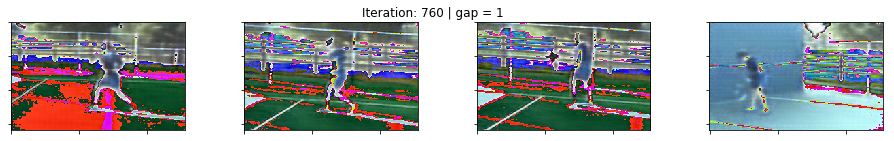

Iteration 760:  G_loss = 818.7674188613892 | Gap = 1


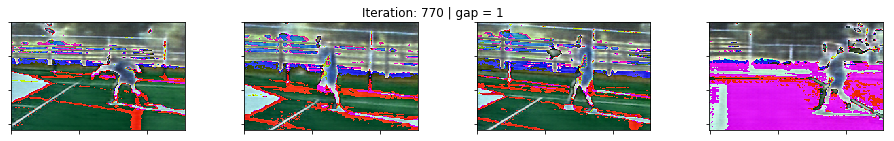

Iteration 770:  G_loss = 832.7543771266937 | Gap = 1


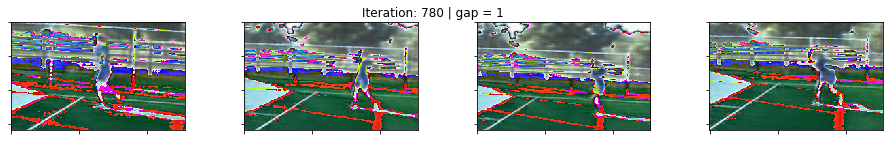

Iteration 780:  G_loss = 824.7732853889465 | Gap = 1


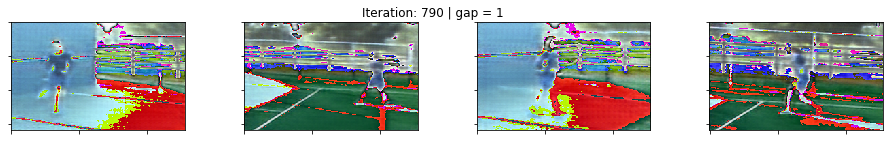

Iteration 790:  G_loss = 808.5428667068481 | Gap = 1


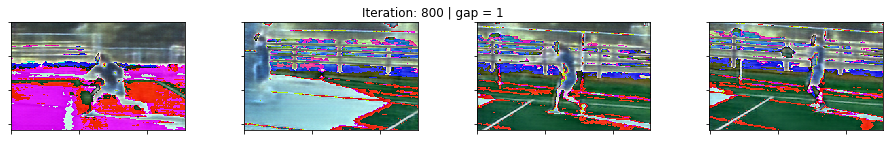

Iteration 800:  G_loss = 862.4635541439056 | Gap = 1


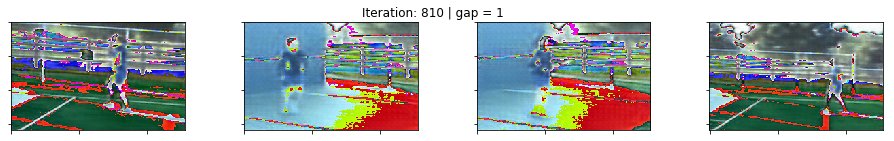

Iteration 810:  G_loss = 818.0165791511536 | Gap = 1


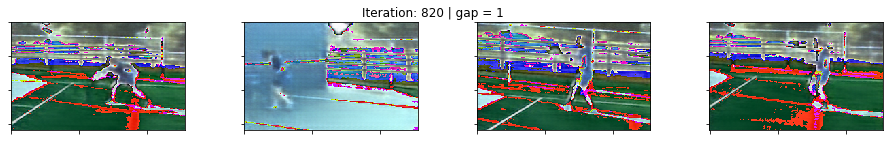

Iteration 820:  G_loss = 795.4562473297119 | Gap = 1


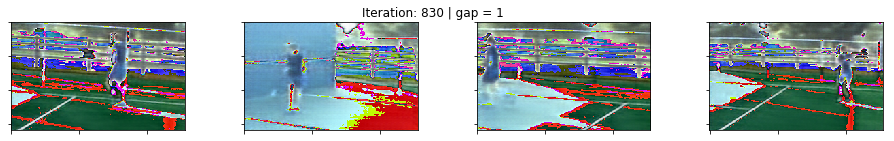

Iteration 830:  G_loss = 812.8853344917297 | Gap = 1


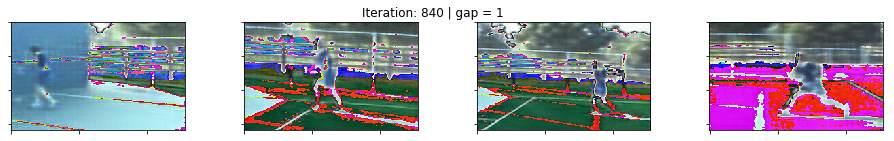

Iteration 840:  G_loss = 794.1883313655853 | Gap = 1


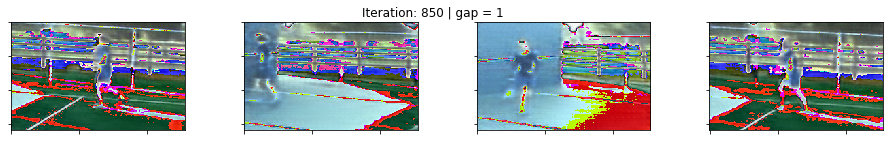

Iteration 850:  G_loss = 793.9460563659668 | Gap = 1


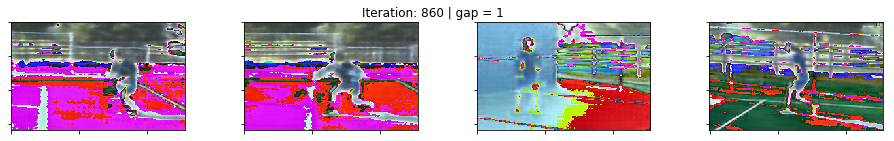

Iteration 860:  G_loss = 811.534309387207 | Gap = 1


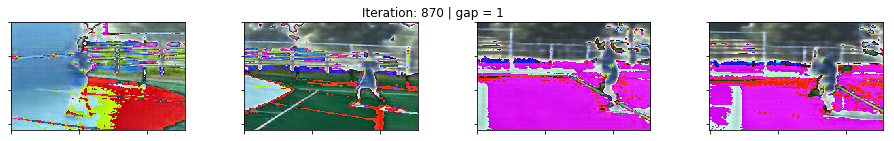

Iteration 870:  G_loss = 802.9234850406647 | Gap = 1


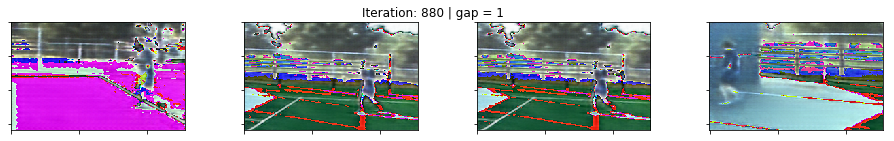

Iteration 880:  G_loss = 805.0334358215332 | Gap = 1


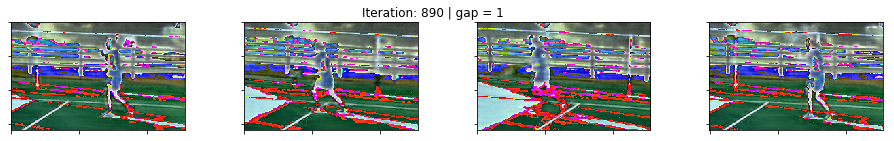

Iteration 890:  G_loss = 811.3347744941711 | Gap = 1


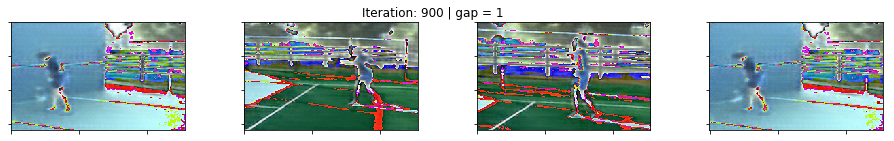

Iteration 900:  G_loss = 821.2091374397278 | Gap = 1


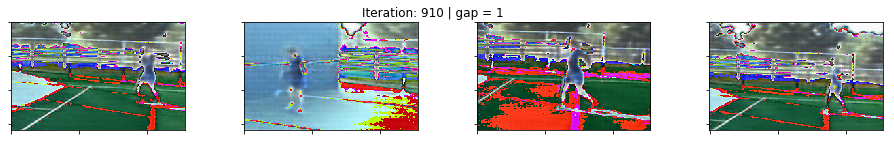

Iteration 910:  G_loss = 796.382120847702 | Gap = 1


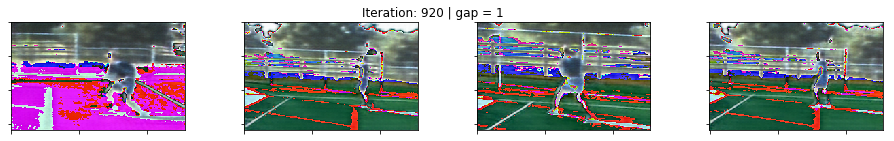

Iteration 920:  G_loss = 779.8803055286407 | Gap = 1


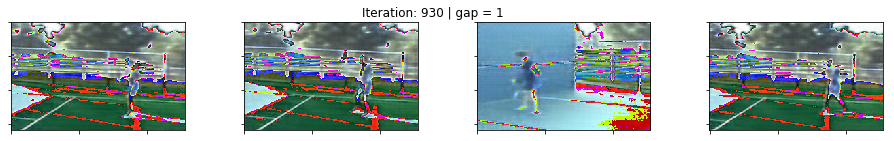

Iteration 930:  G_loss = 786.8566703796387 | Gap = 1


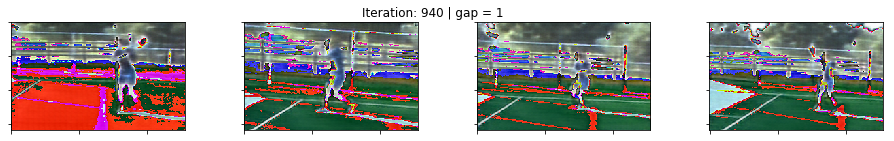

Iteration 940:  G_loss = 845.525643825531 | Gap = 1


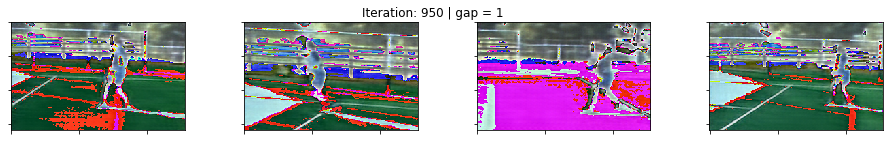

Iteration 950:  G_loss = 815.7777392864227 | Gap = 1


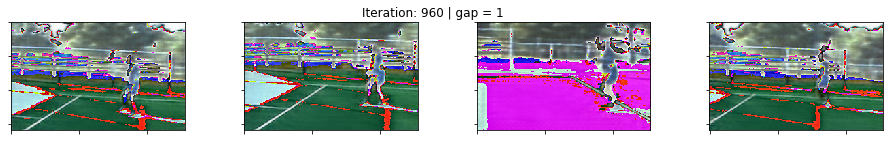

Iteration 960:  G_loss = 796.6961967945099 | Gap = 1


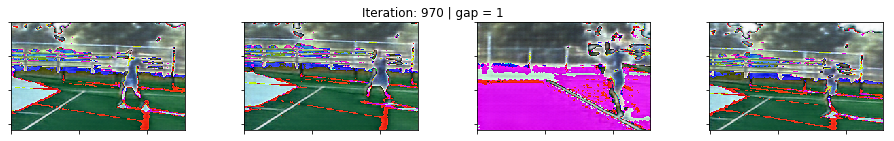

Iteration 970:  G_loss = 798.4754741191864 | Gap = 1


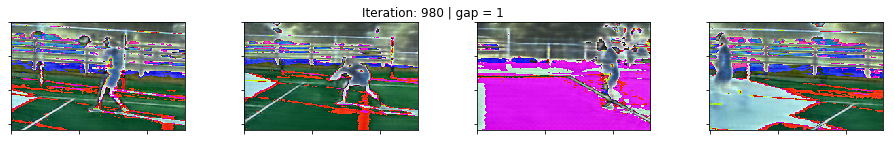

Iteration 980:  G_loss = 774.5636308193207 | Gap = 1


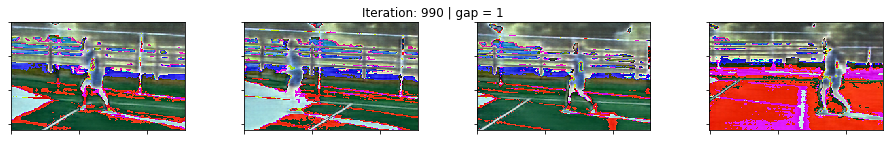

Iteration 990:  G_loss = 763.1327497959137 | Gap = 1


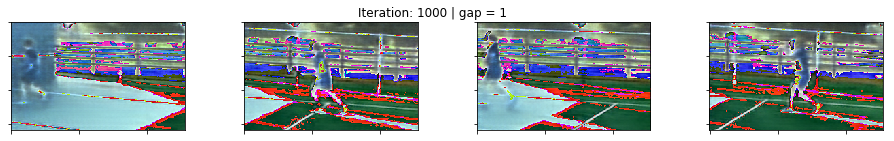

In [23]:
sess = get_session()
sess.run(tf.global_variables_initializer())
g_loss = train(sess, G_train_step, G_loss, batch_size, num_iteration, plot_every = 10, show_loss_every = 10, num_plot=4)

## Plot Learning Curve

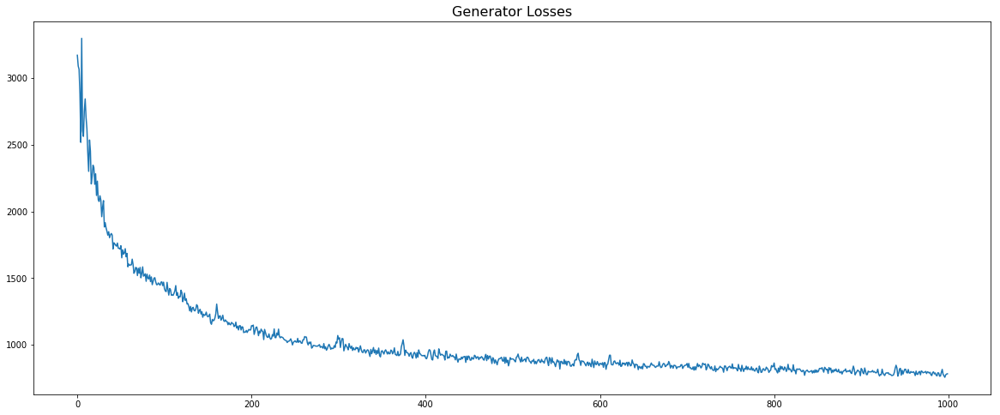

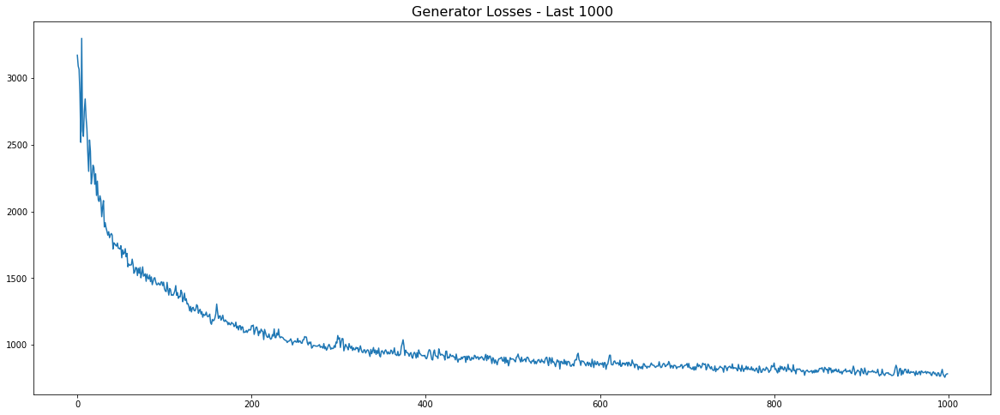

In [26]:
figsize = (20, 8)

plt.figure(figsize=figsize)
plt.plot(g_loss)
plt.title("Generator Losses", fontsize=16)
plt.show()

plt.figure(figsize=figsize)
plt.plot(g_loss[-1000:])
plt.title("Generator Losses - Last 1000", fontsize=16)
plt.show()

# Evaluate !

In [27]:
def show_generations(name, num = 6, gap = 3):
    if name == "train":  before, after, mid = sample_train(num, gap)
    else:                before, after, mid = sample_test(num, gap) 
    
    gen_batch = get_generattion(before, after, mid)
    size = (20, 2)
    plot_images(before, size, "Before")
    plot_images(after, size, "After")
    plot_images(mid, size, "Mid - Real")
    plot_images(gen_batch, size, "Mid - Generated")

## - Evaluate on Training Data

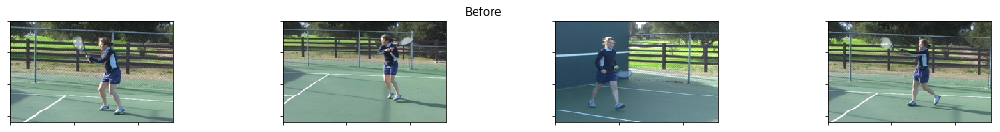

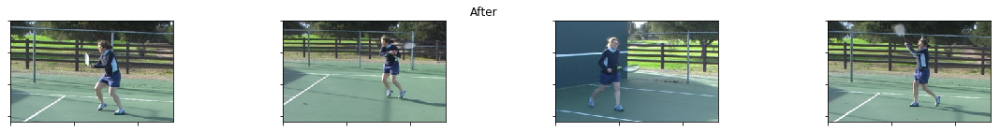

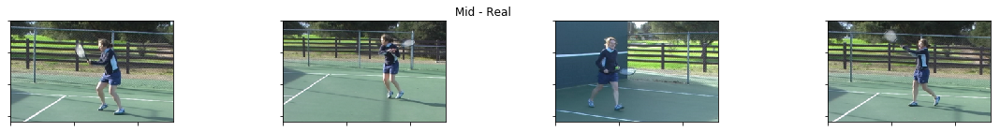

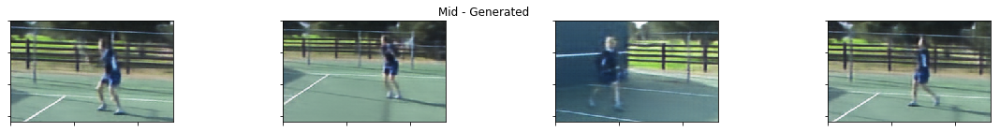

Training Loss = 786.3282251358032


In [32]:
def eval_train(num_show = 8, gap = 3):
    show_generations("train", num_show, gap)
    loss = report_loss("train", 100, gap, batch_size)
    print("Training Loss = {}".format(loss))
    return loss

train_loss = eval_train(num_show = 4, gap = gap)

## - Evaluate on Test Data

In [ ]:
def eval_test(num_show = 6, gap = 3, num_test = 100, batch_size = batch_size):
    show_generations("test", num_show, gap)
    loss = report_loss("test", num_test, gap, batch_size)
    print("Test Loss = {}".format(loss))
    return loss

test_collection = get_collection("data/moving-box/test")
test_collection = augment_reverse_color(test_collection)
test_collection = center_collections(test_collection)
test_loss = eval_test(num_show = 8, gap=1, batch_size = 8)

## How much overfitting?

In [ ]:
print("(Test Loss - Train Loss)/Train Loss = {}".format((test_loss-train_loss)/train_loss))